In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.cm as cm
import matplotlib
import matplotlib.pyplot as plt
from itertools import *
from pylab import *
import time
from scipy.spatial import Voronoi, voronoi_plot_2d, Delaunay, ConvexHull
from collections import defaultdict, Counter
import itertools
from itertools import combinations
from shapely.geometry import LineString, MultiPolygon, MultiPoint, Point
import collections
from matplotlib.collections import LineCollection
from scipy.ndimage import label
import matplotlib.colors as mcolors
import matplotlib.patches as patches
import networkx as nwx
import math
import random
from matplotlib.ticker import PercentFormatter
import seaborn as sns

matplotlib.rcParams.update({'font.size': 10})
matplotlib.rcParams['mathtext.fontset'] = 'dejavusans'

coords_gemma = np.genfromtxt('gemma_1.txt', delimiter='\t')
coords_boundary = np.genfromtxt('boundary_gemma_1.txt', delimiter='\t')

points = list(coords_gemma/5)

boundary_points = list(coords_boundary/5)

gemma_size = len(points)
points = points + boundary_points

#plt.figure(3)
#plt.scatter(*zip(*points))
#plt.scatter(*zip(*boundary_points))
#plt.show()

extra_points = 2000;
points = np.array(points)

tri = Delaunay(points)
vor = Voronoi(points)
neiList=defaultdict(set)

new_len = gemma_size

def compute_gabriel_graph(points):
    #delaunay triangulation
    delaunay = Delaunay(points)
    edges = []

    # iteration through the edges of the Delaunay triangulation
    for simplex in delaunay.simplices:
        for i in range(3):
            for j in range(i + 1, 3):
                p1, p2 = points[simplex[i]], points[simplex[j]]
                mid_point = (p1 + p2)/2
                radius = np.linalg.norm(p1 - p2)/2

                is_gabriel = True

                #check if any other point lies within the circle
                for k in range(len(points)):
                    if k != simplex[i] and k != simplex[j]:  #exclude points on the current edge
                        if np.linalg.norm(points[k] - mid_point) < radius:
                            is_gabriel = False
                            break

                if is_gabriel:
                    edges.append((simplex[i], simplex[j]))

    return edges

for Q in tri.simplices:
    for i,j in itertools.combinations(Q,2):
        if (i < gemma_size) & (j < gemma_size):
            neiList[i].add(j)
            neiList[j].add(i)
        
def index_vertices(a1,a2): ##this computes the corresponding index for vertices between cells (a1,a2)
    ss = -1; BB = [];       #is there a better way?
    for Q in tri.simplices:
        ss = ss + 1
        for i,j in itertools.combinations(Q,2):
            if ([i,j] == [a1,a2]) or ([i,j] == [a2,a1]):
                BB.append(ss)
    return np.array(BB)

length = {}  ###lenght of shared sides between cells k and j
sum_len_neig = {} ###sum of these lengths shared between neighbours
    
for k in range(0,new_len):
    sl = 0;
    for j in neiList[k]:
        LL = vor.vertices[index_vertices(k,j)]
        length[k,j] = np.sqrt((LL[0] - LL[1])[0]**2 + (LL[0] - LL[1])[1]**2)
        sl = sl + length[k,j]
    sum_len_neig[k] = sl

perimeter = np.zeros(vor.npoints)  
area = np.zeros(vor.npoints)

for i, reg_num in enumerate(vor.point_region):
    indices = vor.regions[reg_num]
    if -1 in indices: # some regions can be opened
        #perimeter[i] = perimeter[i]  ## = np.infnp.inf
        area[i] = area[i] ## = np.inf
    else:
        #perimeter[i] = ConvexHull(vor.vertices[indices]).area ##in 2D this is the perimeter
        area[i] = ConvexHull(vor.vertices[indices],qhull_options='QJ').volume ##in 2D this is the area
        #hull = ConvexHull(vor.vertices[indices])
        
p = tri.points[tri.simplices]

# Triangle vertices
A = p[:,0,:].T
B = p[:,1,:].T
C = p[:,2,:].T

#see http://en.wikipedia.org/wiki/Circumscribed_circle#Circumscribed_circles_of_triangles
#the following is just a direct transcription of the formula there

a1 = A - C
b1 = B - C

def dot2(u, v):
    return u[0]*v[0] + u[1]*v[1]

def cross2(u, v, w):
    """u x (v x w)"""
    return dot2(u, w)*v - dot2(u, v)*w

def ncross2(u, v):
    """|| u x v ||^2"""
    return sq2(u)*sq2(v) - dot2(u, v)**2

def sq2(u):
    return dot2(u, u)

cc = cross2(sq2(a1)*b1 - sq2(b1)*a1, a1, b1) / (2*ncross2(a1, b1)) + C

# grab the Voronoi edges
vc = cc[:,tri.neighbors]
vc[:,tri.neighbors == -1] = np.nan # edges at infinity, plotting those would need more work...



/var/folders/_r/xkdhrm6554zgpd1gd9935s3m0000gq/T/ipykernel_60808/3614232153.py:145: RuntimeWarning: divide by zero encountered in divide
  cc = cross2(sq2(a1)*b1 - sq2(b1)*a1, a1, b1) / (2*ncross2(a1, b1)) + C
/var/folders/_r/xkdhrm6554zgpd1gd9935s3m0000gq/T/ipykernel_60808/3614232153.py:145: RuntimeWarning: invalid value encountered in divide
  cc = cross2(sq2(a1)*b1 - sq2(b1)*a1, a1, b1) / (2*ncross2(a1, b1)) + C


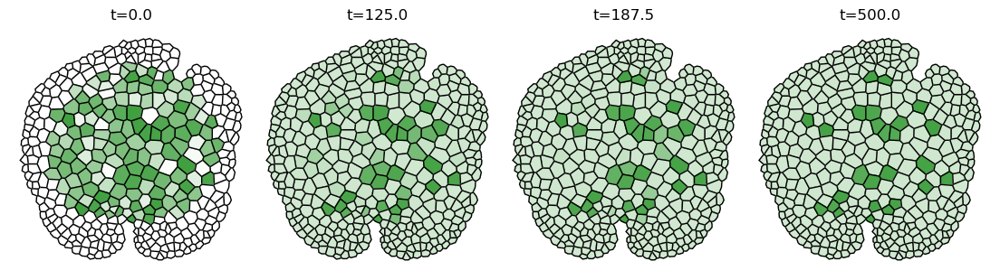

Simulation 0
Proportion of rhizoid cells: 0.1793103448275862


/var/folders/_r/xkdhrm6554zgpd1gd9935s3m0000gq/T/ipykernel_60808/2513233837.py:235: DeprecationWarning: Calling np.sum(generator) is deprecated, and in the future will give a different result. Use np.sum(np.fromiter(generator)) or the python sum builtin instead.
  rhizoid_neighbors = sum(1 for nei in neiList[cell] if rhizoid_cells[nei])


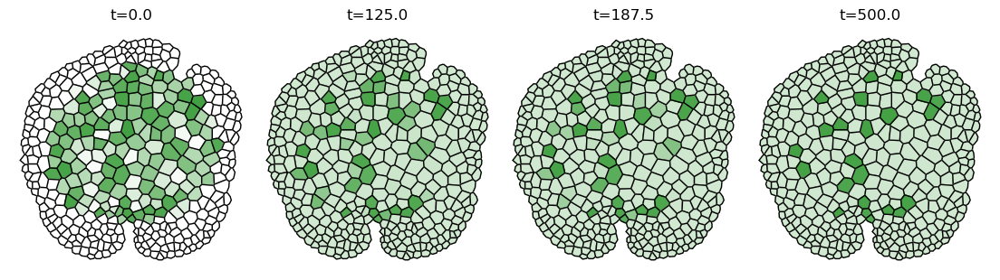

Simulation 1
Proportion of rhizoid cells: 0.15862068965517243


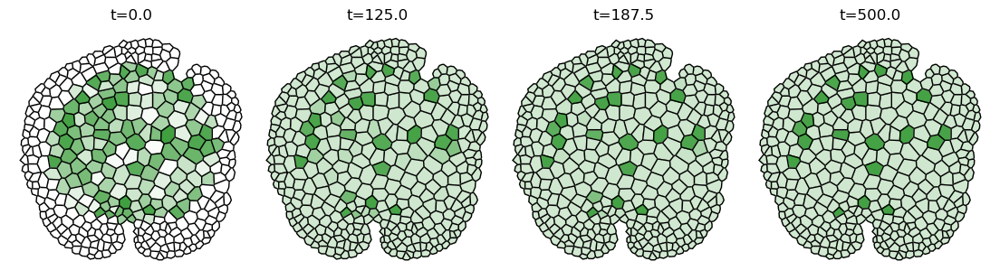

Simulation 2
Proportion of rhizoid cells: 0.14482758620689656


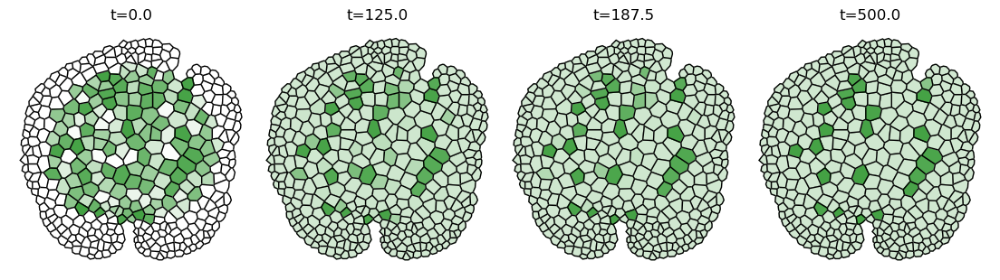

Simulation 3
Proportion of rhizoid cells: 0.15172413793103448


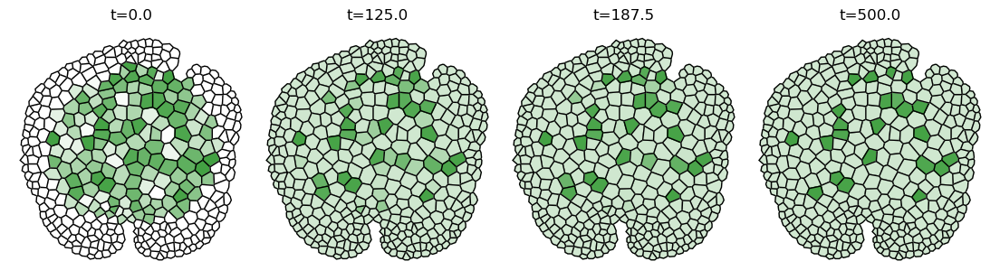

Simulation 4
Proportion of rhizoid cells: 0.15172413793103448


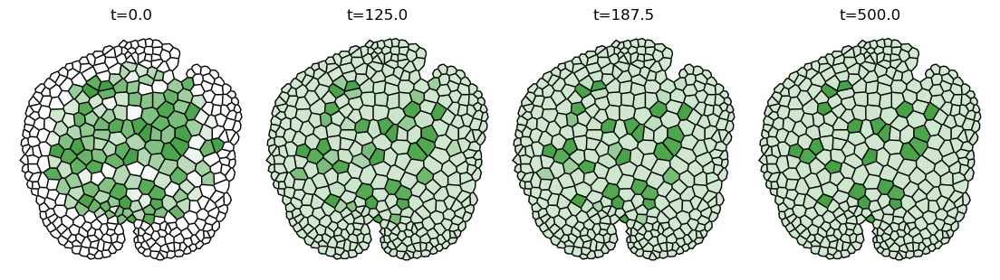

Simulation 5
Proportion of rhizoid cells: 0.15862068965517243


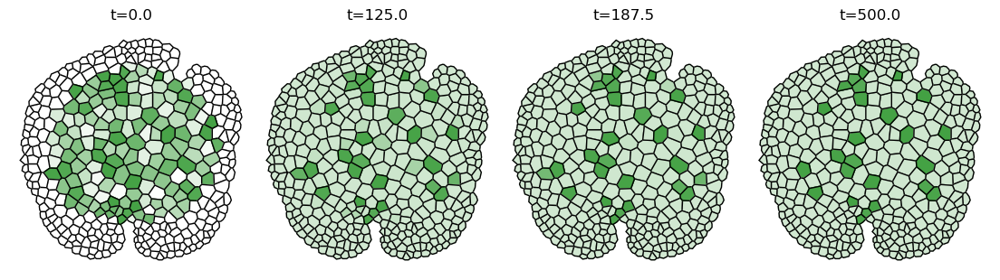

Simulation 6
Proportion of rhizoid cells: 0.1724137931034483


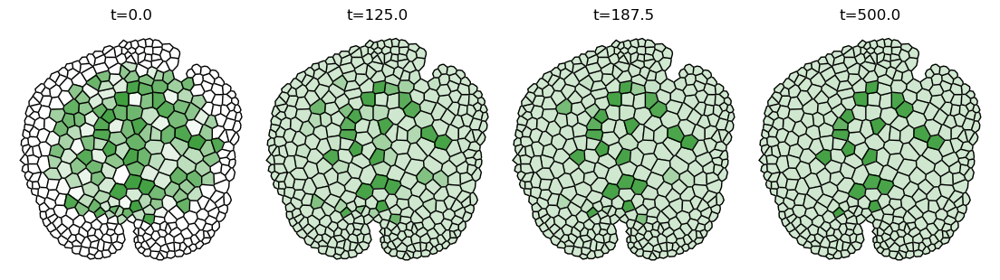

Simulation 7
Proportion of rhizoid cells: 0.11724137931034483


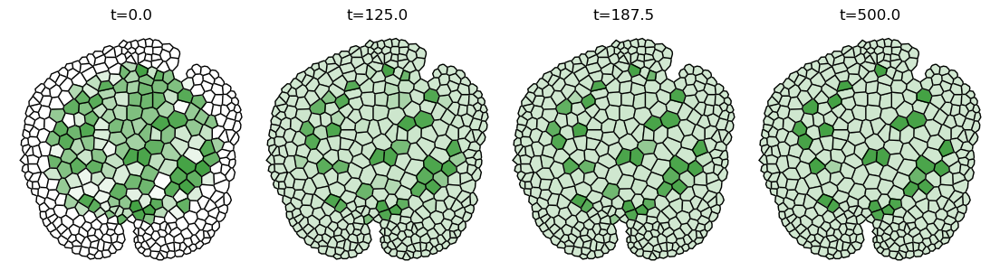

Simulation 8
Proportion of rhizoid cells: 0.16551724137931034


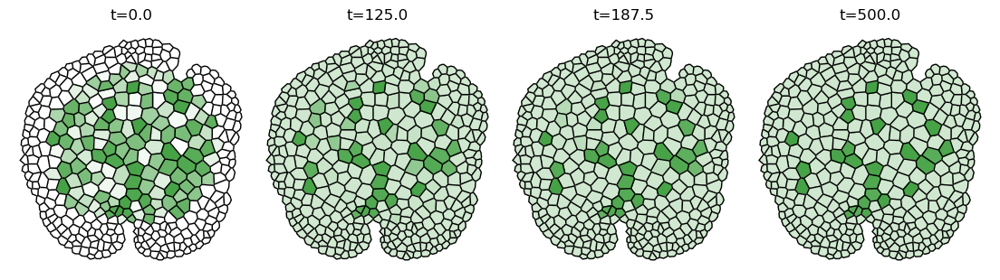

Simulation 9
Proportion of rhizoid cells: 0.1724137931034483


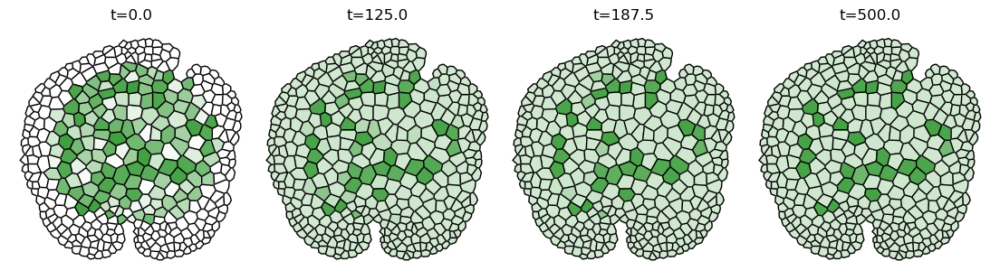

Simulation 10
Proportion of rhizoid cells: 0.1793103448275862


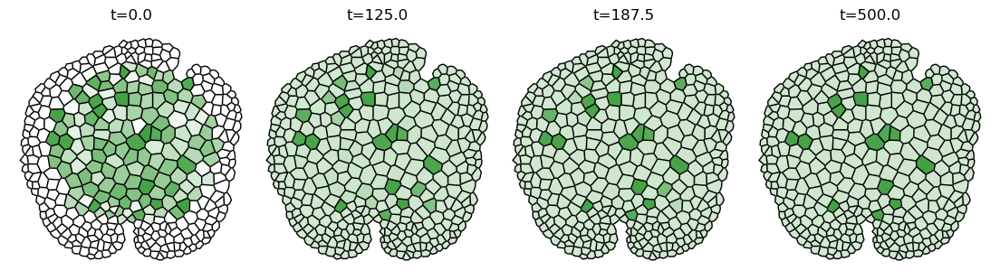

Simulation 11
Proportion of rhizoid cells: 0.10344827586206896


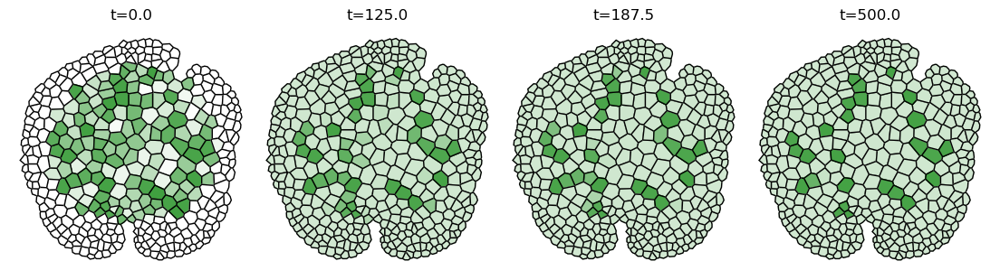

Simulation 12
Proportion of rhizoid cells: 0.1724137931034483


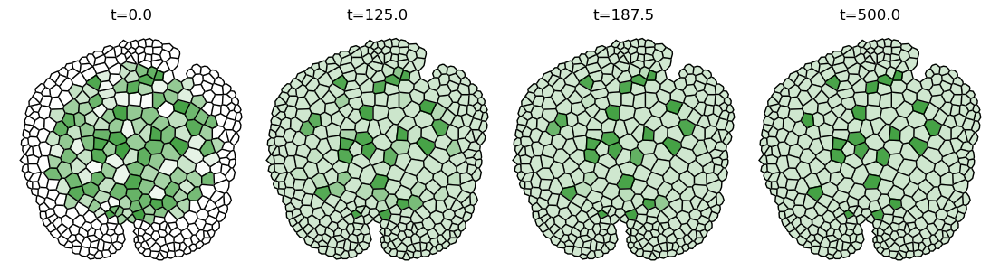

Simulation 13
Proportion of rhizoid cells: 0.13793103448275862


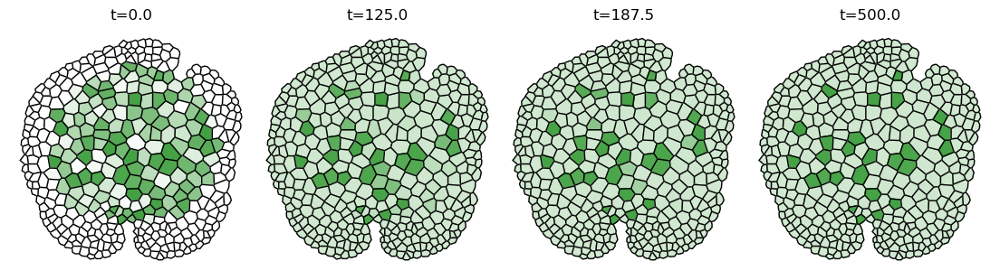

Simulation 14
Proportion of rhizoid cells: 0.1793103448275862


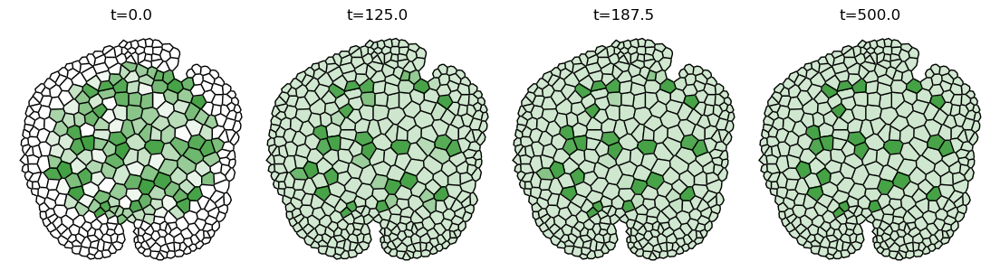

Simulation 15
Proportion of rhizoid cells: 0.15862068965517243


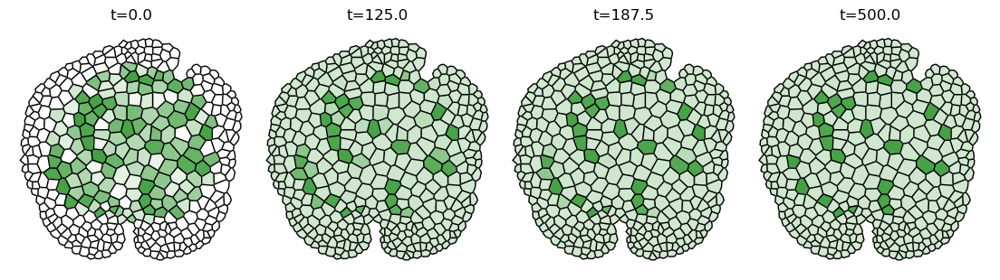

Simulation 16
Proportion of rhizoid cells: 0.1724137931034483


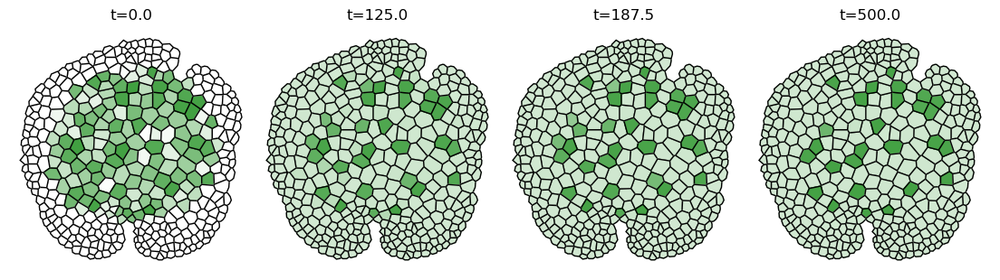

Simulation 17
Proportion of rhizoid cells: 0.1793103448275862


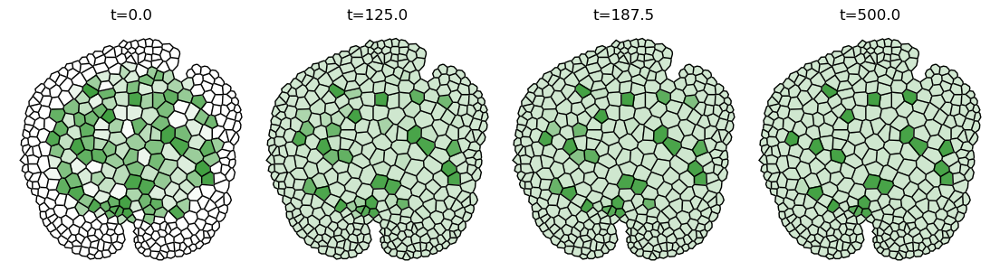

Simulation 18
Proportion of rhizoid cells: 0.1310344827586207


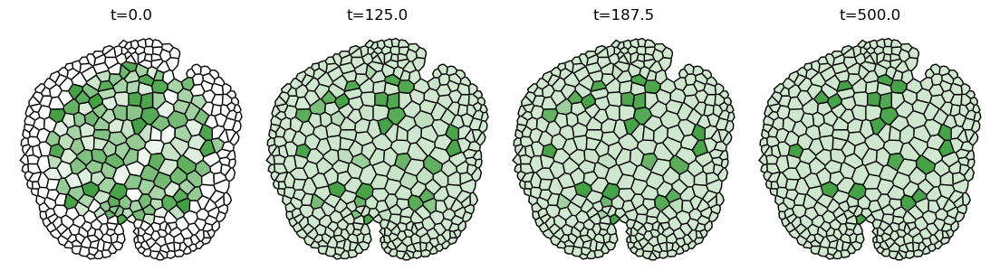

Simulation 19
Proportion of rhizoid cells: 0.1310344827586207


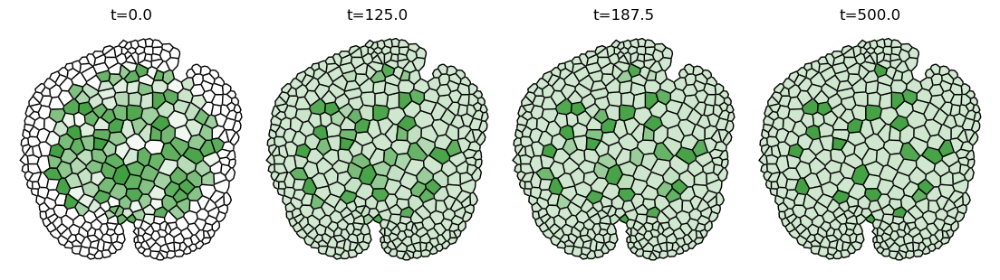

Simulation 20
Proportion of rhizoid cells: 0.15172413793103448


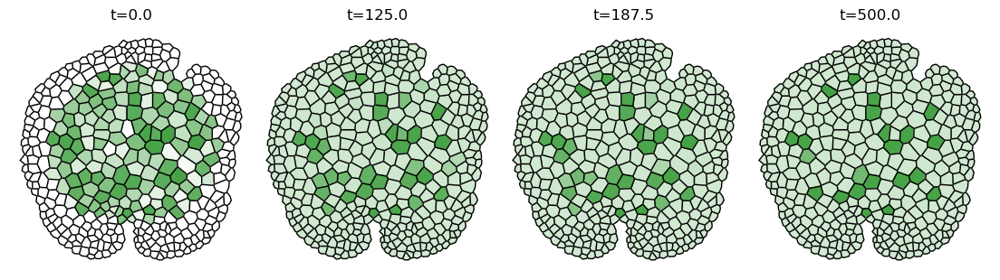

Simulation 21
Proportion of rhizoid cells: 0.13793103448275862


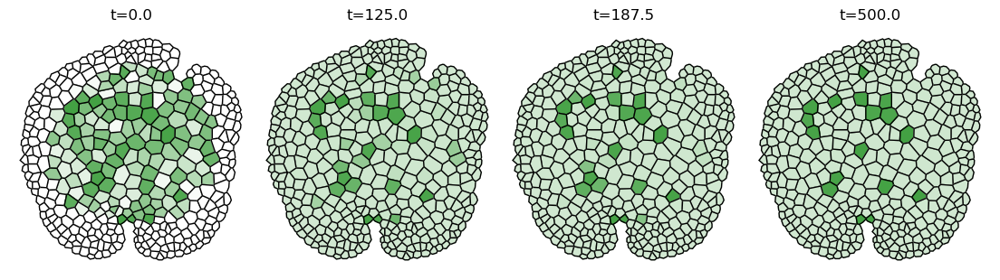

Simulation 22
Proportion of rhizoid cells: 0.11724137931034483


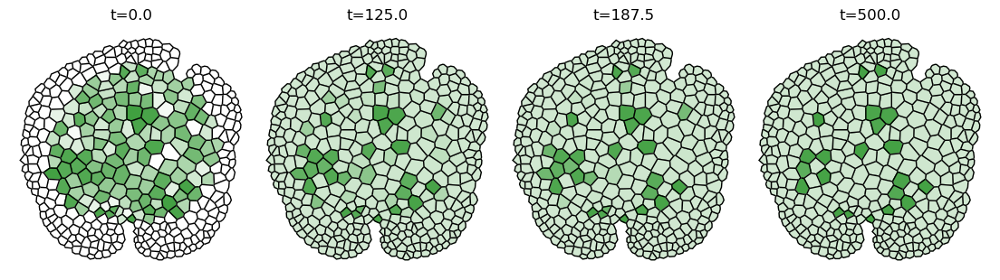

Simulation 23
Proportion of rhizoid cells: 0.14482758620689656


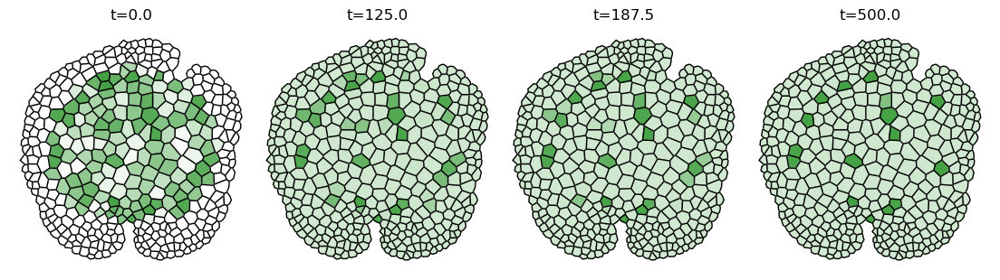

Simulation 24
Proportion of rhizoid cells: 0.10344827586206896


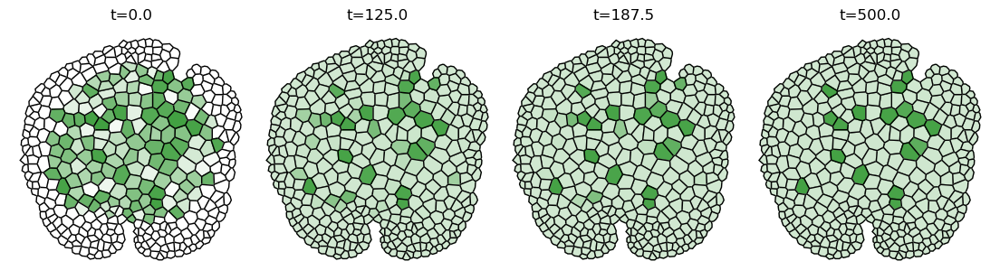

Simulation 25
Proportion of rhizoid cells: 0.11724137931034483


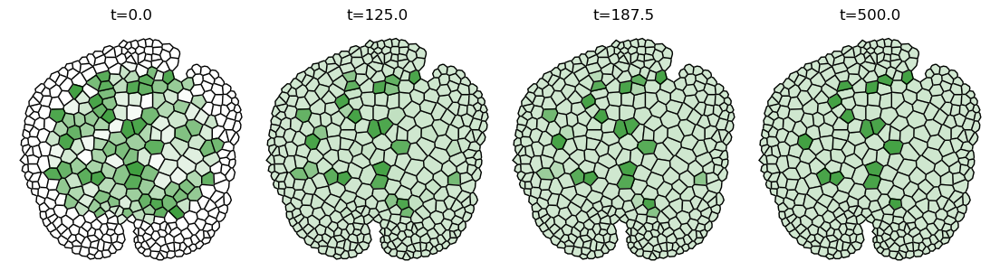

Simulation 26
Proportion of rhizoid cells: 0.10344827586206896


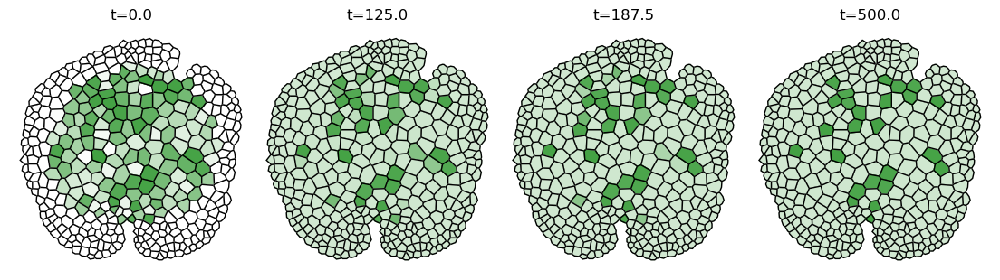

Simulation 27
Proportion of rhizoid cells: 0.1724137931034483


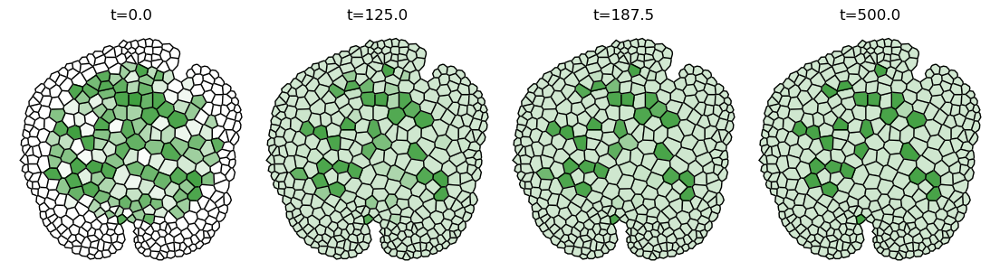

Simulation 28
Proportion of rhizoid cells: 0.16551724137931034


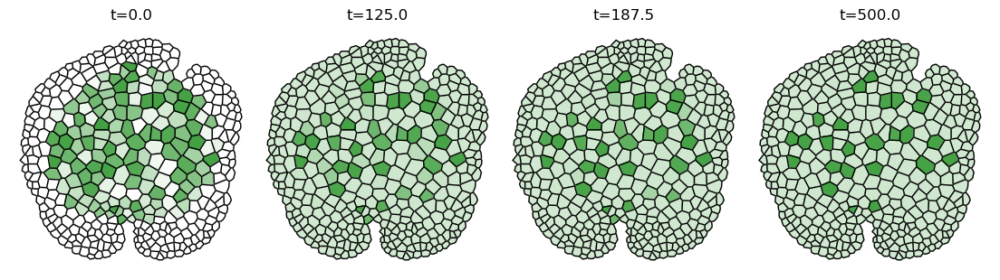

Simulation 29
Proportion of rhizoid cells: 0.1724137931034483


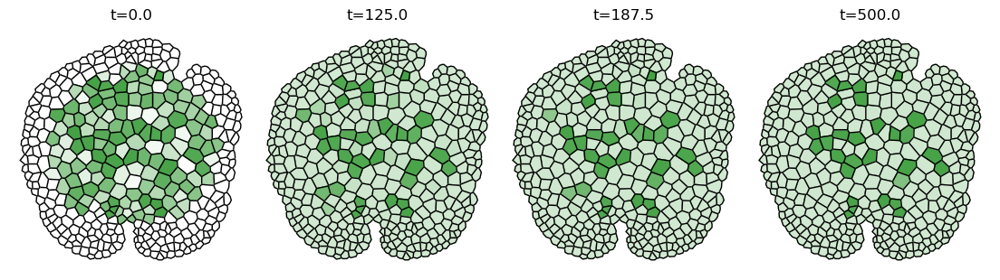

Simulation 30
Proportion of rhizoid cells: 0.19310344827586207


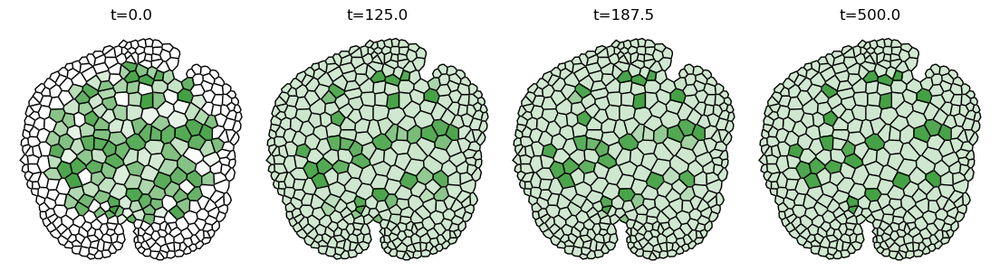

Simulation 31
Proportion of rhizoid cells: 0.16551724137931034


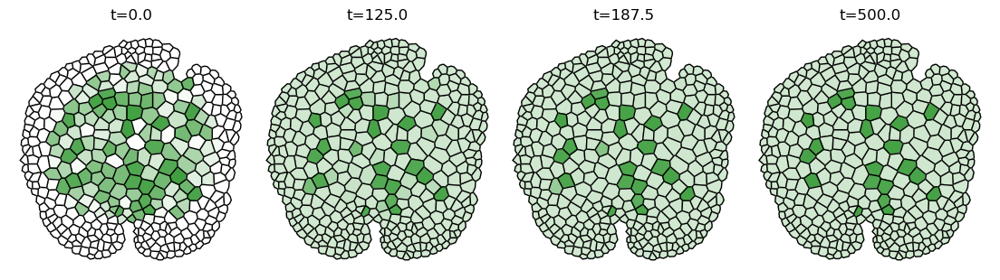

Simulation 32
Proportion of rhizoid cells: 0.14482758620689656


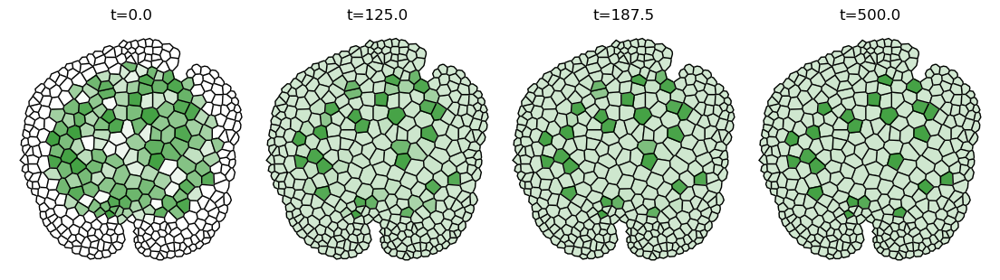

Simulation 33
Proportion of rhizoid cells: 0.15862068965517243


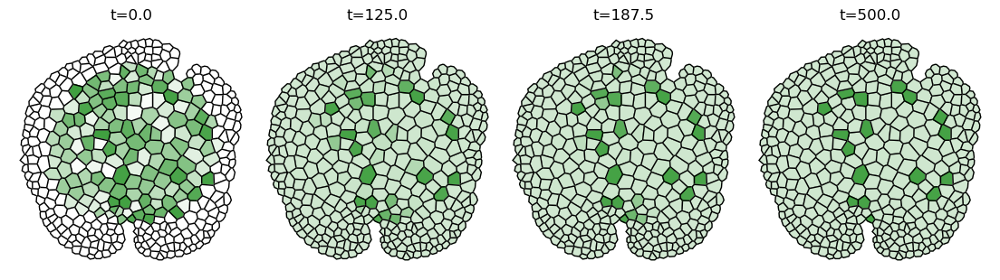

Simulation 34
Proportion of rhizoid cells: 0.11724137931034483


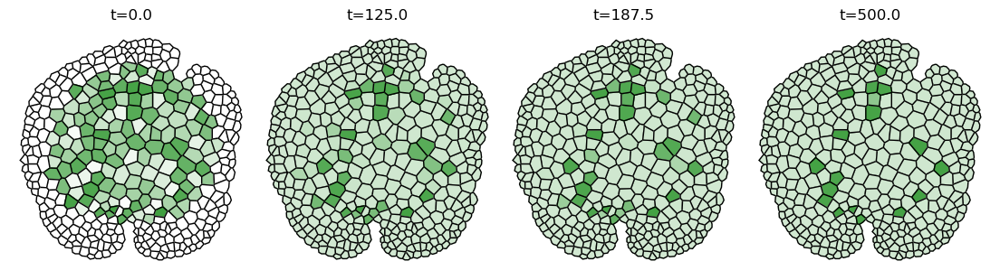

Simulation 35
Proportion of rhizoid cells: 0.11724137931034483


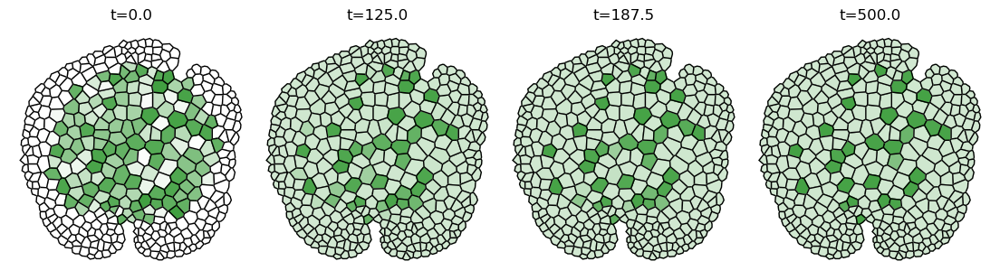

Simulation 36
Proportion of rhizoid cells: 0.18620689655172415


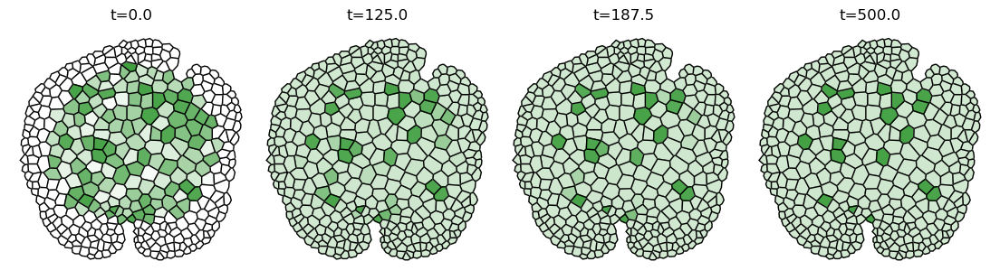

Simulation 37
Proportion of rhizoid cells: 0.12413793103448276


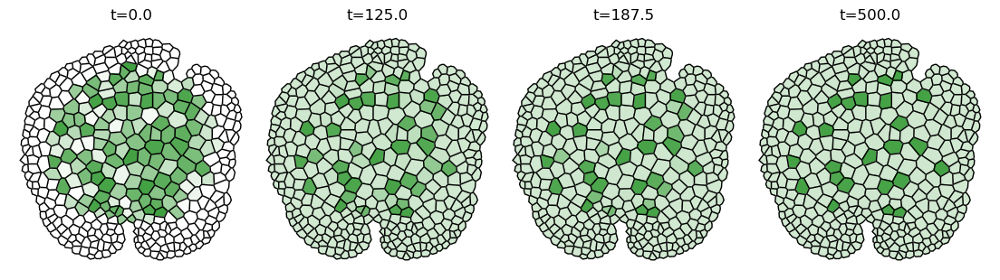

Simulation 38
Proportion of rhizoid cells: 0.1724137931034483


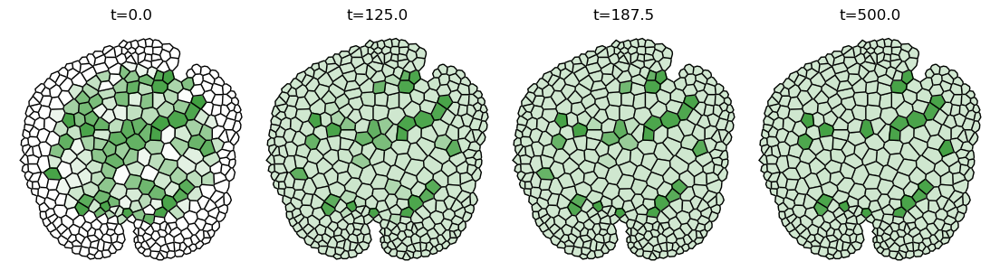

Simulation 39
Proportion of rhizoid cells: 0.13793103448275862


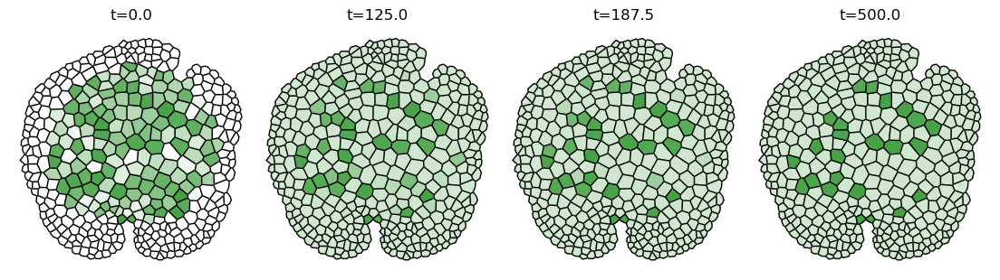

Simulation 40
Proportion of rhizoid cells: 0.16551724137931034


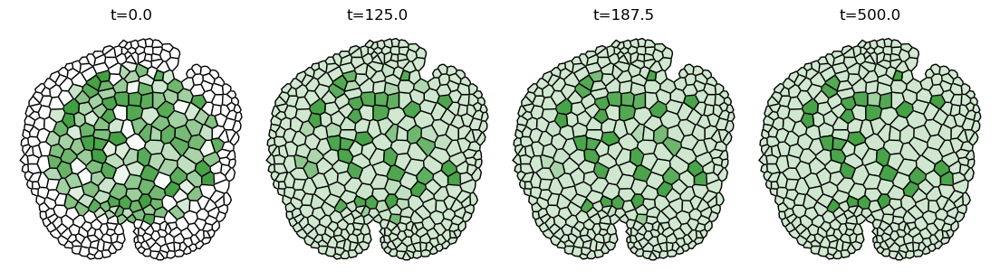

Simulation 41
Proportion of rhizoid cells: 0.18620689655172415


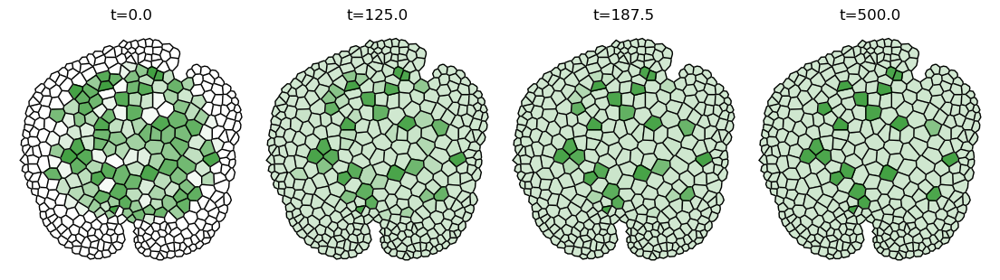

Simulation 42
Proportion of rhizoid cells: 0.13793103448275862


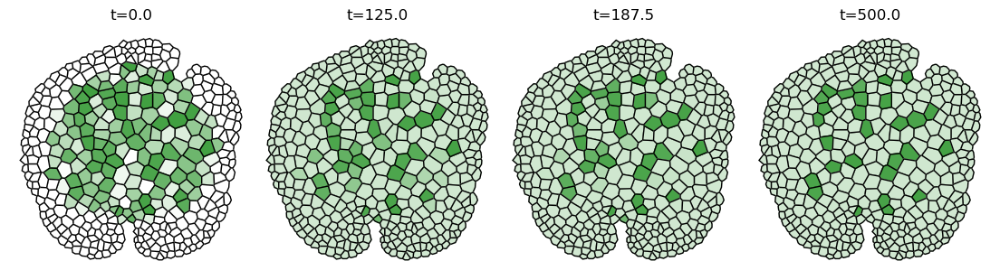

Simulation 43
Proportion of rhizoid cells: 0.19310344827586207


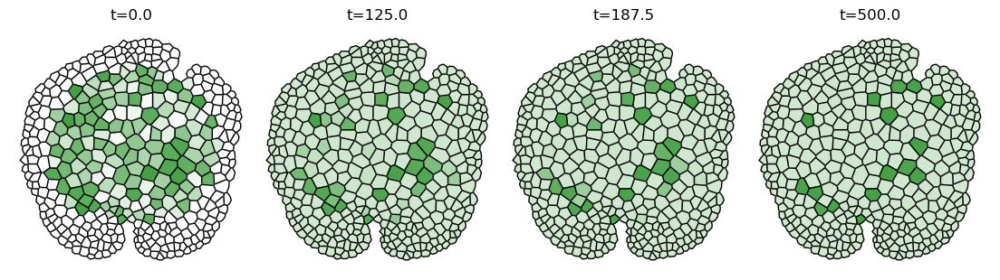

Simulation 44
Proportion of rhizoid cells: 0.1103448275862069


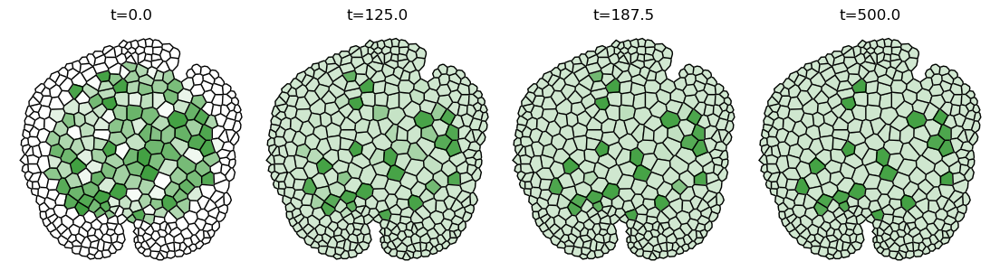

Simulation 45
Proportion of rhizoid cells: 0.1310344827586207


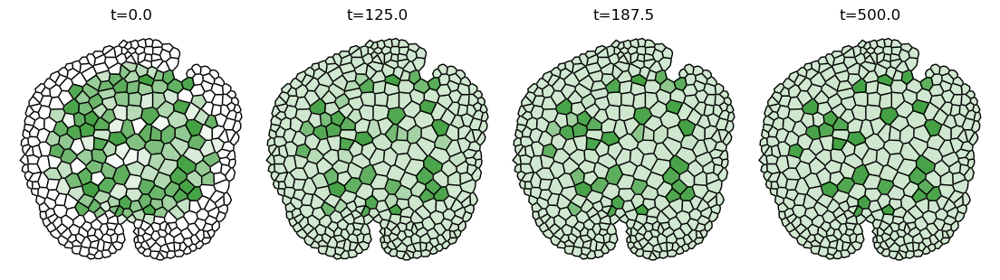

Simulation 46
Proportion of rhizoid cells: 0.1724137931034483


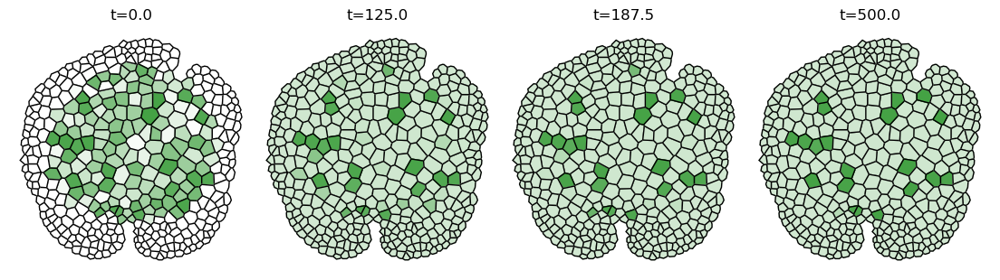

Simulation 47
Proportion of rhizoid cells: 0.13793103448275862


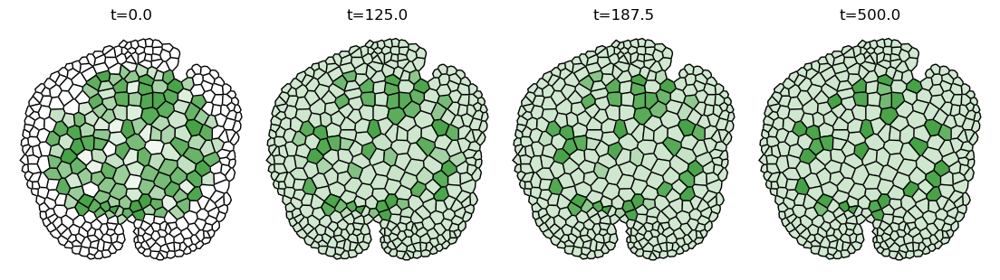

Simulation 48
Proportion of rhizoid cells: 0.1793103448275862


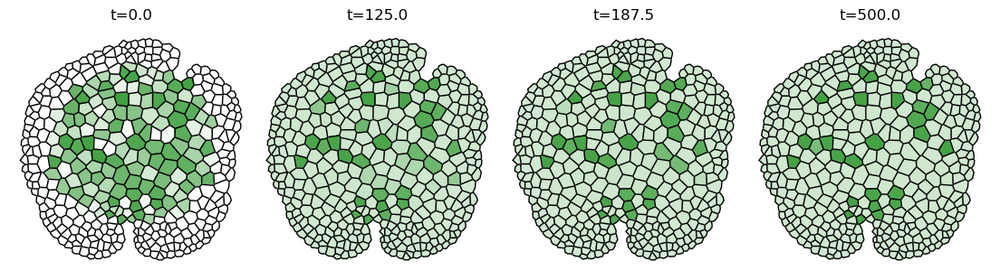

Simulation 49
Proportion of rhizoid cells: 0.1724137931034483


In [2]:
def diff(x,k):
    K = 0; J = 0;
    for i in neiList[k]:
        K = K + (x[i] - x[k])*length[k,i]/sum_len_neig[k]
    return K

#model rhizoids
a0 = 0.4; a = 2; b = 0.1; g0 = 0.1; g = 0.78; kr = 1.2; kf = 2;
kc = 1; nr = 4; nf = 4; dm = 1; dr = 0.1; df = 1;
D = 0.6;

dt = 0.4; total_time = 500;

noise = 1;
p = 0.18

Nsim = 50;

DENSITY_RHIZOID_model = {}
LSP_model = {} #dictionary for the length of the shortest path between pairs of rhizoid cells
CSD_model = {} #dictionary for the cluster size distribution
CS_model = {} #dictionary for the cluster sizes
ND_model = {} #dictionary for the neighbour density

m0 = 0.0; R0 = 1.5; F0 = 0;

for kk in range(0,Nsim):

    m = m0*(noise*(np.random.random(new_len + extra_points)))
    R = R0*(noise*(np.random.random(new_len + extra_points)))
    F = F0*(noise*(np.random.random(new_len + extra_points)))

    morph = np.zeros(gemma_size + extra_points)
    a_morph = np.zeros(gemma_size + extra_points)
    
    Rrand = np.random.choice([1,0.], size=gemma_size + extra_points, p=[p, 1-p])
    
    T = np.zeros(int(total_time/dt)+1)
    MM = np.zeros((gemma_size + extra_points,int(total_time/dt)+1))
    RR = np.zeros((gemma_size + extra_points,int(total_time/dt)+1))
    FF = np.zeros((gemma_size + extra_points,int(total_time/dt)+1))
    MORPH = np.zeros((gemma_size + extra_points,int(total_time/dt)+1))
    
    t = 0; s = -1;
    Rrand = Rrand[0:new_len]
    m = m[0:new_len]; R = R[0:new_len]; F = F[0:new_len]; morph = morph[0:new_len]; a_morph = a_morph[0:new_len]
    MM = MM[0:new_len,:]; RR = RR[0:new_len,:]; FF = FF[0:new_len,:]; MORPH = MORPH[0:new_len,:]
    
    a_morph[0] = 50
    a_morph[4] = 50
    Dmorph = 1
    
    while t <= total_time:
        t = t + dt
        for j in range(new_len):
            morph[j] = morph[j] + dt*( a_morph[j] - 0.4*morph[j] + Dmorph*diff(morph,j) ) 
        MORPH[:,s] = morph[:]
    
    t = 0;
    
    thres = 0.015 ###this ensures we have 145 cells in total (similar to 147 on average from the experiments)
    A = a*((morph**12)/(thres**12 + morph**12))

    m[A<1] = 0.
    R[A<1] = 0.
    F[A<1] = 0.
            
    #activate for random model (and remember to comment the dynamics of variables, and time does not matter, so set it short)
    #R = Rrand
    
    while t <= total_time:
        t = t + dt
        T[s] = t
        s = s + 1

        MM[:,s] = m[:]
        RR[:,s] = R[:]
        FF[:,s] = F[:]

        for j in range(new_len):
        
            m[j] = m[j] + dt*( a0 + A[j]*(R[j]**nr)/(kr**nr + R[j]**nr) - kc*m[j]*F[j] - dm*m[j] )
            R[j] = R[j] + dt*( b*m[j] - dr*R[j] )
            F[j] = F[j] + dt*( g0 + g*(R[j]**nf)/(kf**nf + R[j]**nf) + D*diff(F,j) - df*F[j] )

            #to check if the neighbours work
            #R[70] = 2
            #R[list(neiList[70])] = 0
                
    fig1, axs = plt.subplots(1,4,figsize = (14,8))
    fig1.subplots_adjust(wspace = 0.01)
    
    cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", ["w","g"])
    
    norm1 = mpl.colors.Normalize(vmin=0, vmax=2, clip=True)
    sm1 = cm.ScalarMappable(norm=norm1, cmap=cmap1)
    sm1.set_array([]);
    #cbar1 = plt.colorbar(sm1, ax = axs[-1], shrink = 0.6)
    #cbar1.ax.set_ylabel('$U$', fontsize = 20)
    
    s = -1;
    for t in [0,total_time/4,3*total_time/8,total_time]:
        s = s + 1
        for k in range(new_len):
            region = vor.regions[vor.point_region[k]]
            if not -1 in region:
                polygon = [vor.vertices[i] for i in region]
                axs[s].fill(*zip(*polygon), color=sm1.to_rgba(RR[k,int(t)]))
                poly = patches.Polygon(polygon, edgecolor='black', fill=None, lw=1)
                axs[s].add_patch(poly)
                axs[s].set_aspect('equal', adjustable='box')
                axs[s].axis('off')
                axs[s].set_title(r't=%.1f'%t, fontsize = 12)
                plt.xticks([])
                plt.yticks([])
                #axs[s].scatter(*zip(*points))
                #axs[s].plot(points[0:new_len,0], points[0:new_len,1], '.')
    plt.show()

    ROI = np.where(A>1)
    
    all_indices = ROI[0]
    rhizoid_indices = np.where((A>1)&(R>1))[0]
    rhizoid_cells = R > 1
    epidermal_indices = np.where((A>1)&(R<1))[0]
    density_rhizoid_cells = len(rhizoid_indices)/len(all_indices)
    rhizoid_points = points[rhizoid_indices]
    
    print('Simulation', kk)
    print('Proportion of rhizoid cells:', density_rhizoid_cells)
    
    rhizoid_points = points[rhizoid_indices]    
    gabriel_rhizoid = compute_gabriel_graph(rhizoid_points)
    
    G_rhizoid = nwx.Graph()
    for point in rhizoid_points:
        G_rhizoid.add_node(tuple(point))
    G_rhizoid.add_edges_from(gabriel_rhizoid)
    
    G = nwx.Graph()
    
    for simplex in tri.simplices:
        for i in range(len(simplex)):
            for j in range(i + 1, len(simplex)):
                p1 = tuple(points[simplex[i]])
                p2 = tuple(points[simplex[j]])
                distance = np.linalg.norm(points[simplex[i]] - points[simplex[j]])
                G.add_edge(p1, p2, weight=distance)
    
    def find_simplices_from_gabriel_graph(G):
        cliques = list(nwx.find_cliques(G))
        # Filter cliques to find simplices (size 3 or more)
        simplices = [clique for clique in cliques if len(clique) >= 3]
        return simplices

    def find_all_cliques(G):
        # Find all cliques in the graph
        cliques = list(nwx.find_cliques(G))
        return cliques
        
    #To compute rhizoid cell neighbours of other rhizoid cells
    neighbors = {label: [] for label in rhizoid_indices}
    
    #gabriel_rhizoid_simplices = np.array(find_simplices_from_gabriel_graph(G_rhizoidk))
    ###making np.array sometimes gives errors because it finds simplices of 4 elements instead of 3, and cannot convert to array
    gabriel_rhizoid_cliques = find_all_cliques(G_rhizoid)
    
    # Find neighbors from the Gabriel graph
    for clique in gabriel_rhizoid_cliques:
        for i in range(len(clique)):
            for j in range(len(clique)):
                if i != j:
                    p1 = rhizoid_indices[clique[i]]
                    p2 = rhizoid_indices[clique[j]]
                    neighbors[p1].append(p2)
    
    # Remove duplicates in neighbors
    for key in neighbors.keys():
        neighbors[key] = list(set(neighbors[key]))
    
    def get_neighbors(label):
        if label in neighbors:
            return neighbors[label]
        else:
            return []
    
    rhizoid_neighbors = {label: get_neighbors(label) for label in rhizoid_indices}
    
    #####
    
    # Find clusters of rhizoid cells
    def find_clusters(rhizoid_cells, neiList):
        visited = np.zeros(len(rhizoid_cells), dtype=bool)
        clusters = []
    
        def dfs(cell, cluster):
            stack = [cell]
            while stack:
                current = stack.pop()
                if not visited[current]:
                    visited[current] = True
                    cluster.append(current)
                    stack.extend([nei for nei in neiList[current] if rhizoid_cells[nei] and not visited[nei]])
    
        for i in range(len(rhizoid_cells)):
            if rhizoid_cells[i] and not visited[i]:
                cluster = []
                dfs(i, cluster)
                clusters.append(cluster)
    
        return clusters
    
    clusters = find_clusters(rhizoid_cells, neiList)
    
    # Compute cluster sizes
    cluster_sizes = [len(cluster) for cluster in clusters]
    
    # Count the number of clusters of each size
    cluster_size_counts = defaultdict(int)
    for size in cluster_sizes:
        cluster_size_counts[size] += 1
    
    sizes = sorted(cluster_size_counts.keys())
    counts = [cluster_size_counts[size] for size in sizes]

    # Compute average number of rhizoid neighbors for each cluster
    def compute_avg_rhizoid_neighbors(clusters, rhizoid_cells, neiList):
        cs = []
        nd = []
    
        for cluster in clusters:
            rhizoid_neighbor_counts = []
    
            for cell in cluster:
                rhizoid_neighbors = sum(1 for nei in neiList[cell] if rhizoid_cells[nei])
                rhizoid_neighbor_counts.append(rhizoid_neighbors)
    
            avg_rhizoid_neighbors = np.mean(rhizoid_neighbor_counts)
            cs.append(len(cluster))
            nd.append(avg_rhizoid_neighbors)
    
        return cs, nd

    cs, nd = compute_avg_rhizoid_neighbors(clusters, rhizoid_cells, neiList)
    
    # Function to find the shortest path between two points
    def find_shortest_path(G, start_label, end_label):
        start_point = tuple(points[start_label])
        end_point = tuple(points[end_label])
        shortest_path = nwx.shortest_path(G, source=start_point, target=end_point, weight='weight')
        return shortest_path
    
    all_pairs = set()
    
    for label in rhizoid_indices:
        for neighbor in rhizoid_neighbors[label]:
            pair = tuple(sorted((label, neighbor)))
            all_pairs.add(pair)
                    
    len_shortest_path = np.zeros(len(all_pairs));

    all_pairs = list(all_pairs)
    
    jj = -1
    for l,j in all_pairs:

        jj = jj + 1
    
        start_label = l
        end_label = j
    
        shortest_path = find_shortest_path(G, start_label, end_label)
        len_shortest_path[jj] = len(shortest_path)-1

    DENSITY_RHIZOID_model[kk] = density_rhizoid_cells
    LSP_model[kk] = len_shortest_path
    CSD_model[kk] = cluster_size_counts
    CS_model[kk] = cs
    ND_model[kk] = nd


/var/folders/_r/xkdhrm6554zgpd1gd9935s3m0000gq/T/ipykernel_60808/3387060453.py:132: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels(['exp.', 'model'], fontsize = 9)


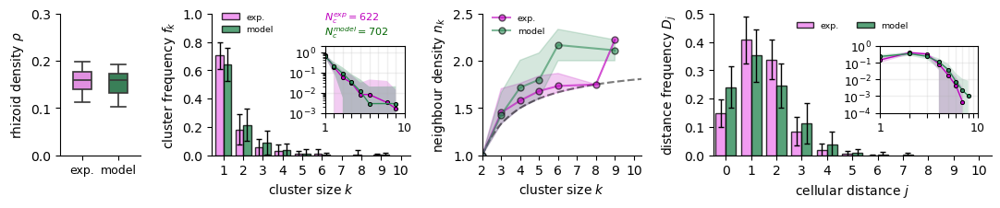

In [4]:
import csv

exp_density = np.load("exp_density.npy")
model_density = list(DENSITY_RHIZOID_model.values())

CS_exp = {}
with open("CS_exp.csv", "r") as f:
    reader = csv.DictReader(f)
    for row in reader:
        key = int(row["Key"])
        value = list(map(int, row["Value"].split(",")))  # Convert the string back to a list of integers
        CS_exp[key] = value

ND_exp = {}
with open("ND_exp.csv", "r") as f:
    reader = csv.reader(f)
    next(reader)  # Skip the header
    for row in reader:
        key = int(row[0])
        values = list(map(float, row[1:]))
        ND_exp[key] = values


CSD_exp = defaultdict(lambda: defaultdict(int))
with open("CSD_exp.csv", "r") as f:
    reader = csv.DictReader(f)
    for row in reader:
        outer_key = int(row["Key"])
        inner_key = int(row["InnerKey"])
        value = int(row["Value"])
        CSD_exp[outer_key][inner_key] = value

LSP_exp = {}
with open("LSP_exp.csv", "r") as f:
    reader = csv.DictReader(f)
    for row in reader:
        key = int(row["Key"])
        value = np.array(list(map(float, row["Array"].split(","))))  # Convert string back to NumPy array
        LSP_exp[key] = value


fig, (ax1,ax2,ax3,ax4) = plt.subplots(1, 4, figsize=(13,2), width_ratios=[1,2.5,2.,3.5])
fig.subplots_adjust(wspace=0.4)

####################
##first plot experimental results

CS = CS_exp
ND = ND_exp
LSP = LSP_exp
CSD = CSD_exp

density_av = np.mean(exp_density)
density_std = np.std(exp_density)

lsp_together = np.concatenate(list(LSP.values()))
csd_together = defaultdict(int)

lspt = collections.OrderedDict(sorted(Counter(lsp_together).items()))

for sub_dict in CSD.values():
    for key, value in sub_dict.items():
        csd_together[key] += value

csd_together = dict(collections.OrderedDict(sorted(csd_together.items())))

all_bins = set()
for values in LSP.values():
    all_bins.update(values)

all_bins = sorted(all_bins)

histograms = []

for values in LSP.values():
    histogram = Counter(values)
    histogram_values = list(histogram.values())
    total = sum(histogram_values)
    
    #print("Histogram values:", histogram_values)
    #print("Total:", total)
    
    if total > 0:
        histogram_normalized = {k: v / total for k, v in histogram.items()}
    else:
        histogram_normalized = {}
    
    histogram_values = [histogram_normalized.get(bin_key, 0) for bin_key in all_bins]
    histograms.append(histogram_values)

histograms_array = np.array(histograms)

mean_histogram = np.mean(histograms_array, axis=0)
std_histogram = np.std(histograms_array, axis=0)

ax4.bar(all_bins - 0.2*np.ones(len(all_bins)), mean_histogram,  color='violet', alpha=0.8, width=0.4, edgecolor='k', align='center', label = 'exp.')
ax4.errorbar(all_bins - 0.2*np.ones(len(all_bins)), mean_histogram, yerr=std_histogram, capsize=2, fmt='o', ms = 0, ecolor='k', linewidth=1)


inset_ax4 = ax4.inset_axes([0.6, 0.3, 0.35, 0.47])

inset_ax4.errorbar(all_bins, mean_histogram, capsize=2, fmt='o-', ecolor='k', linewidth=1, elinewidth=1, 
                  ms=3, color = 'm', markeredgecolor='k', markeredgewidth=0.7)
inset_ax4.fill_between(all_bins, mean_histogram + std_histogram, mean_histogram - std_histogram, alpha = 0.2, linewidth=0, color = 'm')


inset_ax4.set_xlim([1,10])
inset_ax4.set_ylim([0.0001,1])

inset_ax4.set_yscale('log')
inset_ax4.set_xscale('log')
inset_ax4.grid(alpha = 0.2, linewidth = 1.);
inset_ax4.set_xticks([1,2,3,4,5,6,7,8,9,10]);
inset_ax4.set_xticklabels(['1', '', '', '', '', '', '', '','', '10'], fontsize = 9)
inset_ax4.set_yticks([0.0001,0.001,0.01,0.1,1]);
inset_ax4.set_yticklabels(['$10^{-4}$','$10^{-3}$', '$10^{-2}$', '$10^{-1}$', '$10^{0}$'], fontsize = 9)


#################

ddd = [exp_density,model_density]

sns.boxplot(ddd,widths = 0.5, palette = ['violet','seagreen'], ax = ax1, linewidth = 1.2)
#sns.stripplot(data=ddd, ax=ax1, marker = 'o', color='w', edgecolor = 'k', jitter = True, linewidth=0.7,size=2.3, alpha = 0.7)

ax1.spines[['right', 'top']].set_visible(False)

ax1.set_ylim(0.,0.3)
ax1.set_xlim(-0.6,1.6)

ax1.set_ylabel(r'rhizoid density $\rho$')
ax1.set_xticklabels(['exp.', 'model'], fontsize = 9)


######################################

css = set()
for clusters in CSD.values():
    css.update(clusters.keys())
css = sorted(css)  #sort for consistent ordering

#initialize variables to hold all normalized distributions
all_normalized = defaultdict(list)

#normalize each simulation's distribution, ensuring all cluster sizes are present
for sim, clusters in CSD.items():
    total_clusters = sum(list(clusters.values()))  # Total number of clusters in the simulation
    
    #create normalized distribution, filling in missing sizes with zero
    normalized = {size: clusters.get(size, 0) / total_clusters for size in css}
    
    #add normalized values to respective size in all_normalized
    for size, fraction in normalized.items():
        all_normalized[size].append(fraction)

#calculate average and standard deviation for each cluster size
css = sorted(all_normalized.keys())
averages = [np.mean(all_normalized[size]) for size in css]
errors = [np.std(all_normalized[size]) for size in css]

averages = np.array(averages)
errors = np.array(errors)

csd = list(csd_together.values())/sum(list(csd_together.values()))
cs = list(csd_together.keys())


ax2.bar(css - 0.2*np.ones(len(css)), averages,  color='violet', alpha=0.8, width=0.4, edgecolor='k', align='center', label = 'exp.')
ax2.errorbar(css - 0.2*np.ones(len(css)), averages, yerr=errors, capsize=2, fmt='o', ms = 0,ecolor='k', linewidth=1)


ax2.set_xlabel(r'cluster size $k$')
ax2.set_ylabel(r'frequency $f_k$')
ax2.set_xticks([1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]);
ax2.set_xticklabels(['1', '', '', '', '', '', '', '','', '10', '', '', '', '', '', '', '', '','','20'])

ax2.set_xlim(0.4,10.5)
ax2.set_ylim(0,1)

ax2.spines[['right', 'top']].set_visible(False)

ax2.annotate(r'$N_{c}^{exp} =  %i$'%(sum(list(csd_together.values()))),[6.1,0.95], fontsize = 8, color = 'm')


inset_ax2 = ax2.inset_axes([0.57, 0.3, 0.4, 0.47])


inset_ax2.errorbar(cs, csd, capsize=2, fmt='o-', ecolor='k', linewidth=1, elinewidth=1, 
                  ms=3, color = 'm', markeredgecolor='k', markeredgewidth=0.7, label = 'model')




inset_ax2.fill_between(css, averages + errors, averages - errors, alpha = 0.2, linewidth=0, color = 'm')

inset_ax2.set_xlim([1,10])
inset_ax2.set_ylim([0.001,2])

inset_ax2.set_yscale('log')
#inset_ax2.set_xscale('log')
inset_ax2.grid(alpha = 0.2, linewidth = 1.);
inset_ax2.set_xticks([1,2,3,4,5,6,7,8,9,10]);
inset_ax2.set_xticklabels(['1', '', '', '', '', '', '', '','', '10'], fontsize = 9)
inset_ax2.set_yticks([0.001,0.01,0.1,1,2]);
inset_ax2.set_yticklabels(['$10^{-3}$', '$10^{-2}$', '$10^{-1}$', '$10^{0}$', ''], fontsize = 9)

######################################
######################################

size_density_data = defaultdict(list)


for sim in ND.keys():

    CCC = []
    cluster_sizes = CS[sim]
    densities = ND[sim]

    for size, density in zip(cluster_sizes, densities):
        if size == 1:
            size_density_data[size].append(0.0)
        else:
            size_density_data[size].append(density)

for sim in CS.keys():
    for size, density in zip(CS[sim], ND[sim]):
        size_density_data[size].append(density)

cluster_sizes = np.array(sorted(size_density_data.keys()))
mean_densities = np.array([np.mean(size_density_data[size]) for size in cluster_sizes])
std_densities = np.array([np.std(size_density_data[size]) for size in cluster_sizes])

min_densities = np.array([np.min(size_density_data[size]) for size in cluster_sizes])
max_densities = np.array([np.max(size_density_data[size]) for size in cluster_sizes])

q1 = np.array([np.percentile(size_density_data[size], 5) for size in cluster_sizes])
q3 = np.array([np.percentile(size_density_data[size], 95) for size in cluster_sizes])

xx = np.linspace(2,20,100)
yy = 2 - 2/xx


ax3.errorbar(cluster_sizes, mean_densities, fmt='-o', ms = 5, 
             ecolor='k', color = 'm', markeredgecolor = 'k', capsize = 2, alpha = 0.6, label = 'exp.')

ax3.plot(xx,yy,'k--', alpha = 0.3)


ax3.fill_between(cluster_sizes,  mean_densities + std_densities, min_densities, color = "m",
                 alpha = 0.2, linestyle = '', linewidth = 1)



################################
#plot model statistics

CS = CS_model
ND = ND_model
LSP = LSP_model
CSD = CSD_model

density_av = np.mean(model_density)
density_std = np.std(model_density)

lsp_together = np.concatenate(list(LSP.values()))
csd_together = defaultdict(int)

lspt = collections.OrderedDict(sorted(Counter(lsp_together).items()))

for sub_dict in CSD.values():
    for key, value in sub_dict.items():
        csd_together[key] += value

csd_together = dict(collections.OrderedDict(sorted(csd_together.items())))

all_bins = set()
for values in LSP.values():
    all_bins.update(values)

all_bins = sorted(all_bins)

histograms = []

for values in LSP.values():
    histogram = Counter(values)
    histogram_values = list(histogram.values())
    total = sum(histogram_values)
    
    #print("Histogram values:", histogram_values)
    #print("Total:", total)
    
    if total > 0:
        histogram_normalized = {k: v / total for k, v in histogram.items()}
    else:
        histogram_normalized = {}
    
    histogram_values = [histogram_normalized.get(bin_key, 0) for bin_key in all_bins]
    histograms.append(histogram_values)

histograms_array = np.array(histograms)

mean_histogram = np.mean(histograms_array, axis=0)
std_histogram = np.std(histograms_array, axis=0)

ax4.bar(all_bins + 0.2*np.ones(len(all_bins)), mean_histogram,  color='seagreen', alpha=0.8, width=0.4, edgecolor='k', align='center', label = 'model')
ax4.errorbar(all_bins + 0.2*np.ones(len(all_bins)), mean_histogram, yerr=std_histogram, capsize=2, fmt='o', ms = 0, ecolor='k', linewidth=1)

ax4.set_xlabel('cellular distance $j$')
ax4.set_ylabel('distance frequency $D_j$')
ax4.set_xticks([1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]);
ax4.set_xticklabels(['0','1', '2', '3', '4', '5', '6', '7', '8','9', '10', '', '', '', '', '', '', '', '',''])

ax4.set_xlim(0.5,11.5)
ax4.set_ylim(0,0.5)
ax4.legend(loc = 'upper center', ncol = 2, fontsize = 6.8, frameon = False)

ax4.spines[['right', 'top']].set_visible(False)


inset_ax4.errorbar(all_bins, mean_histogram, capsize=2, fmt='o-', ecolor='k', linewidth=1, elinewidth=1, 
                  ms=3, color = 'seagreen', markeredgecolor='k', markeredgewidth=0.7)
inset_ax4.fill_between(all_bins, mean_histogram + std_histogram, mean_histogram - std_histogram, alpha = 0.2, linewidth=0, color = 'seagreen')


#################

css = set()
for clusters in CSD.values():
    css.update(clusters.keys())
css = sorted(css)  

all_normalized = defaultdict(list)

for sim, clusters in CSD.items():
    total_clusters = sum(list(clusters.values()))
    
    normalized = {size: clusters.get(size, 0) / total_clusters for size in css}
    
    for size, fraction in normalized.items():
        all_normalized[size].append(fraction)

css = sorted(all_normalized.keys())
averages = [np.mean(all_normalized[size]) for size in css]
errors = [np.std(all_normalized[size]) for size in css]

averages = np.array(averages)
errors = np.array(errors)

csd = list(csd_together.values())/sum(list(csd_together.values()))
cs = list(csd_together.keys())


ax2.bar(css + 0.2*np.ones(len(css)), averages,  color='seagreen', alpha=0.8, width=0.4, edgecolor='k', align='center', label = 'model')
ax2.errorbar(css + 0.2*np.ones(len(css)), averages, yerr=errors, capsize=2, fmt='o', ms = 0,ecolor='k', linewidth=1)

ax2.set_xlabel(r'cluster size $k$')
ax2.set_ylabel(r'cluster frequency $f_k$')
ax2.set_xticks([1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]);
ax2.set_xticklabels(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '', '', '', '', '', '', '', '','','20'])

ax2.set_xlim(0.4,10.5)
ax2.set_ylim(0,1)

ax2.spines[['right', 'top']].set_visible(False)

ax2.legend(bbox_to_anchor=(0., 0.56, 0.35, 0.5), ncol = 1, fontsize = 6.8, frameon = False)


inset_ax2.errorbar(cs, csd, capsize=2, fmt='o-', ecolor='k', linewidth=1, elinewidth=1, 
                  ms=3, color = 'seagreen', markeredgecolor='k', markeredgewidth=0.7, label = 'model')
inset_ax2.fill_between(css, averages + errors, averages - errors, alpha = 0.3, linewidth=0, color = 'seagreen')


ax2.annotate(r'$N_{c}^{model} =  %i$'%(sum(list(csd_together.values()))),[6.1,0.845], fontsize = 8, color = 'darkgreen')

######################################
######################################

size_density_data = defaultdict(list)


for sim in ND.keys():

    CCC = []
    cluster_sizes = CS[sim]
    densities = ND[sim]

    for size, density in zip(cluster_sizes, densities):
        if size == 1:
            size_density_data[size].append(0.0)
        else:
            size_density_data[size].append(density)

for sim in CS.keys():
    for size, density in zip(CS[sim], ND[sim]):
        size_density_data[size].append(density)

cluster_sizes = np.array(sorted(size_density_data.keys()))
mean_densities = np.array([np.mean(size_density_data[size]) for size in cluster_sizes])
std_densities = np.array([np.std(size_density_data[size]) for size in cluster_sizes])

min_densities = np.array([np.min(size_density_data[size]) for size in cluster_sizes])
max_densities = np.array([np.max(size_density_data[size]) for size in cluster_sizes])

q1 = np.array([np.percentile(size_density_data[size], 5) for size in cluster_sizes])
q3 = np.array([np.percentile(size_density_data[size], 95) for size in cluster_sizes])

xx = np.linspace(2,20,100)
yy = 2 - 2/xx


ax3.errorbar(cluster_sizes, mean_densities, fmt='-o', ms = 5, 
             ecolor='k', color = 'seagreen', markeredgecolor = 'k', capsize = 2, alpha = 0.6, label = 'model')

ax3.plot(xx,yy,'k--', alpha = 0.3)


ax3.fill_between(cluster_sizes, mean_densities + std_densities, min_densities, color = "seagreen",
                 alpha = 0.2, linestyle = '', linewidth = 1)

ax3.set_xlabel(r'cluster size $k$')
ax3.set_ylabel(r'neighbour density $n_k$')
ax3.set_xticks([0,1,2,3,4,5,6,7,8,9,10,11]);
ax3.set_xticklabels(['','', '2', '3', '4', '5', '6', '7', '8','9', '10',''])

ax3.set_xlim(2,10.4)
ax3.set_ylim(1,2.5)
ax3.legend(bbox_to_anchor=(0., 0.55, 0.44, 0.5), ncol = 1, fontsize = 6.8, frameon = False)

ax3.spines[['right', 'top']].set_visible(False)


plt.savefig('figure_exp_model.pdf', transparent = True, bbox_inches='tight')
plt.savefig('figure_exp_model.svg')

plt.show()
